## Loading Libraries and data

In [1]:
import torch
import numpy as np
from torch.utils.data import DataLoader, TensorDataset
import warnings
warnings.filterwarnings('ignore')

device = torch.device("cuda:3" if torch.cuda.is_available() else "cpu")

In [2]:
## Loading BOLD5000 data

BOLD_brain_signals_train = torch.load("BOLD5000_train_test/brain_signals_train.pt", map_location=device)
BOLD_brain_signals_test = torch.load("BOLD5000_train_test/brain_signals_test.pt", map_location=device)

BOLD_brain_signals_train = torch.from_numpy(BOLD_brain_signals_train).to(device)
BOLD_brain_signals_test = torch.from_numpy(BOLD_brain_signals_test).to(device)

# Normalizing the BOLD signals

mean = BOLD_brain_signals_train.mean(0)
std = BOLD_brain_signals_train.std(0)
BOLD_brain_signals_train = (BOLD_brain_signals_train - mean) / std
BOLD_brain_signals_test = (BOLD_brain_signals_test - mean) / std

BOLD_brain_signals_train = torch.nan_to_num(BOLD_brain_signals_train)
BOLD_brain_signals_test = torch.nan_to_num(BOLD_brain_signals_test)


BOLD_stimulus_embeddings_train = torch.load( "BOLD5000_train_test/image_embeddings_train.pt", map_location=device)
BOLD_stimulus_embeddings_test = torch.load("BOLD5000_train_test/image_embeddings_test.pt", map_location=device)

BOLD_subject_ids_train = torch.load("BOLD5000_train_test/subject_ids_train.pt", map_location=device)
BOLD_subject_ids_test = torch.load("BOLD5000_train_test/subject_ids_test.pt", map_location=device)

# Loading NSD data

NSD_train_data = np.load("/srv/nfs-data/sisko/kashif/decoding_NSD/data_fmri_nsd/train_data.npy")
NSD_train_data = torch.from_numpy(NSD_train_data).to(device)

NSD_test_data = np.load("/srv/nfs-data/sisko/kashif/decoding_NSD/data_fmri_nsd/test_data.npy")
NSD_test_data = torch.from_numpy(NSD_test_data).to(device)

NSD_train_clip_img_embeds = torch.load("/srv/nfs-data/sisko/kashif/decoding_NSD/data_fmri_nsd/train_clip_img_embeds.pt", map_location=device)
NSD_test_clip_img_embeds = torch.load("/srv/nfs-data/sisko/kashif/decoding_NSD/data_fmri_nsd/test_clip_img_embeds.pt", map_location=device)


NSD_subject_train_ids = np.load("/srv/nfs-data/sisko/kashif/decoding_NSD/data_fmri_nsd/subject_train_ids.npy")
NSD_subject_test_ids = np.load("/srv/nfs-data/sisko/kashif/decoding_NSD/data_fmri_nsd/subject_test_ids.npy")

NSD_subject_train_ids=[int(i[-1]) for i in NSD_subject_train_ids]
NSD_subject_test_ids=[int(i[-1]) for i in NSD_subject_test_ids]

NSD_subject_train_ids = torch.from_numpy(np.array(NSD_subject_train_ids)).to(device)
NSD_subject_test_ids = torch.from_numpy(np.array(NSD_subject_test_ids)).to(device)

In [3]:
BOLD_brain_signals_train.shape, BOLD_brain_signals_test.shape, BOLD_stimulus_embeddings_train.shape, BOLD_stimulus_embeddings_test.shape, BOLD_subject_ids_train.shape, BOLD_subject_ids_test.shape, NSD_train_data.shape, NSD_test_data.shape, NSD_train_clip_img_embeds.shape, NSD_test_clip_img_embeds.shape, NSD_subject_train_ids.shape, NSD_subject_test_ids.shape

(torch.Size([15095, 15724]),
 torch.Size([3775, 15724]),
 torch.Size([15095, 2, 1, 1280]),
 torch.Size([3775, 2, 1, 1280]),
 torch.Size([15095]),
 torch.Size([3775]),
 torch.Size([35436, 15724]),
 torch.Size([3928, 15724]),
 torch.Size([35436, 2, 1, 1280]),
 torch.Size([3928, 2, 1, 1280]),
 torch.Size([35436]),
 torch.Size([3928]))

## Combining NSD and BOLD data

In [4]:
# Convert BOLD5000 brain signals to tensor
BOLD_brain_signals_train = torch.tensor(BOLD_brain_signals_train).float()
BOLD_brain_signals_test = torch.tensor(BOLD_brain_signals_test).float()

# Extract CLIP embeddings from BOLD5000
BOLD_stimulus_embeddings_train = BOLD_stimulus_embeddings_train[:, 1, 0].float()
BOLD_stimulus_embeddings_test = BOLD_stimulus_embeddings_test[:, 1, 0].float()

# Convert NSD brain signals to tensor
NSD_train_data = torch.tensor(NSD_train_data).float()
NSD_test_data = torch.tensor(NSD_test_data).float()

# Extract CLIP embeddings from NSD
NSD_train_clip_img_embeds = NSD_train_clip_img_embeds[:, 1, 0].float()
NSD_test_clip_img_embeds = NSD_test_clip_img_embeds[:, 1, 0].float()

# Concatenate datasets
combined_train_data = torch.cat([NSD_train_data, BOLD_brain_signals_train], dim=0)
combined_test_data = torch.cat([NSD_test_data, BOLD_brain_signals_test], dim=0)

combined_train_embeds = torch.cat([NSD_train_clip_img_embeds, BOLD_stimulus_embeddings_train], dim=0)
combined_test_embeds = torch.cat([NSD_test_clip_img_embeds, BOLD_stimulus_embeddings_test], dim=0)

combined_train_subjects = torch.cat([torch.tensor(NSD_subject_train_ids,  device=device), torch.tensor(BOLD_subject_ids_train, device=device)], dim=0)
combined_test_subjects = torch.cat([torch.tensor(NSD_subject_test_ids, device=device), torch.tensor(BOLD_subject_ids_test, device=device)], dim=0)


## Defining model

In [6]:
import torch
import torch.nn as nn
import pytorch_lightning as pl


class Encoder(nn.Module):
    def __init__(self, input_dim, hidden_dims, output_dim, act_fn=nn.ReLU, alignment_layers_keys=[1, 2, 5, 7, 8, 9, 10, 11], common_dim=1024): #,  
        super(Encoder, self).__init__()
        self.common_dim = common_dim
        self.alignment_layers = nn.ModuleDict({str(k): nn.Linear(input_dim, common_dim) for k in alignment_layers_keys})
        
        layers = [nn.LayerNorm(common_dim)]
        prev_dim = common_dim
        for hidden_dim in hidden_dims:
            layers.append(nn.Linear(prev_dim, hidden_dim))
            layers.append(nn.LayerNorm(hidden_dim))
            layers.append(act_fn())
            prev_dim = hidden_dim
        layers.append(nn.Linear(prev_dim, output_dim))
        layers.append(nn.LayerNorm(output_dim))
        self.net = nn.Sequential(*layers)
                # Alignment layer
        self.alignment_layer = nn.Linear(output_dim, output_dim)

    def forward(self, x, k=None):
        if k is None:
            k = torch.ones(len(x), dtype=torch.long)
        
        result = torch.zeros(len(x), self.common_dim, device=x.device)
        for key in k.unique():
            mask = (k == key)
            result[mask] = self.alignment_layers[str(key.item())](x[mask])
        
            #Alignment layer
        aligned_result = self.net(result)
        aligned_result = self.alignment_layer(aligned_result)
        return aligned_result #self.net(result)

class ContrastiveModel(pl.LightningModule):
    def __init__(self, num_input_channels, base_channel_size, latent_dim, temperature=0.1, act_fn=nn.GELU, loss_type="contrastive"):
        super().__init__()
        self.temperature = temperature
        self.model = Encoder(num_input_channels, base_channel_size, latent_dim, act_fn)
        self.loss_type = loss_type

        if loss_type == "contrastive":
            self.loss_fn = self.contrastive_loss
        elif loss_type == "mean_contrastive":
            self.loss_fn = self.mean_contrastive
        elif loss_type == "mse":
            self.loss_fn = torch.nn.functional.mse_loss
        elif loss_type == "cosine":
            self.loss_fn = self.cosine_loss

        self.train_losses = []
        self.train_mse = []
        self.train_cosine = []
        self.val_losses = []
        self.val_mse = []
        self.val_cosine = []

        self.train_history = {
            "train_loss": [],
            "train_mse": [],
            "train_cosine": []
        }
        
        self.val_history = {
            "val_loss": [],
            "val_mse": [],
            "val_cosine": []
        }

    def forward(self, x, **kwargs):
        return self.model(x, **kwargs)
 
    def contrastive_loss(self, z_i, z_j):
        z_i = nn.functional.normalize(z_i, dim=1)
        z_j = nn.functional.normalize(z_j, dim=1)
        
        logits = (z_i @ z_j.T) / self.temperature
        targets = torch.arange(logits.shape[0]).long().to(logits.device)
        
        # Original cross-entropy loss
        loss1 = torch.nn.functional.cross_entropy(logits, targets)
        
        # Transposed cross-entropy loss
        loss2 = torch.nn.functional.cross_entropy(logits.T, targets)
        
        # Combined loss
        loss = 0.5 * loss1 + 0.5 * loss2
    
        return loss


    def mean_contrastive(self, z_i, z_j, temperature=1.0):
        return nn.functional.mse_loss(z_i, z_j) + self.contrastive_loss(z_i, z_j, temperature=temperature) / 8
    
    def cosine_loss(self, z_i, z_j, temperature=1.0):
        cosine_similarity = torch.nn.functional.cosine_similarity(z_i, z_j).mean()
        return 1 - cosine_similarity

    def training_step(self, batch, batch_idx):
        x, y, idx = batch
        y_hat = self(x, k=idx)
        loss = self.loss_fn(y_hat, y)
        self.log('train_loss', loss, on_epoch=True, prog_bar=True)
        self.train_losses.append(loss.item())

        mse_loss = torch.nn.functional.mse_loss(y_hat, y)
        cosine_similarity = torch.nn.functional.cosine_similarity(y_hat, y).mean()
        self.train_mse.append(mse_loss.item())
        self.train_cosine.append(cosine_similarity.item())

        return loss

    def validation_step(self, batch, batch_idx):
        x, y, idx = batch
        y_hat = self(x, k=idx)
        loss = self.loss_fn(y_hat, y)
        self.log('val_loss', loss, on_epoch=True, prog_bar=True)
        
        mse_loss = torch.nn.functional.mse_loss(y_hat, y)
        self.log('val_mse_loss', mse_loss, on_epoch=True, prog_bar=True)
        
        cosine_similarity = torch.nn.functional.cosine_similarity(y_hat, y).mean()
        self.log('val_cosine_similarity', cosine_similarity, on_epoch=True, prog_bar=True)
        
        self.val_losses.append(loss.item())
        self.val_mse.append(mse_loss.item())
        self.val_cosine.append(cosine_similarity.item())
        return mse_loss

    def on_train_epoch_end(self):
        self.train_history["train_loss"].append(np.mean(self.train_losses))
        self.train_history["train_mse"].append(np.mean(self.train_mse))
        self.train_history["train_cosine"].append(np.mean(self.train_cosine))
        self.train_losses = []
        self.train_mse = []
        self.train_cosine = []
        super().on_train_epoch_end()

    def on_validation_epoch_end(self):
        self.val_history["val_loss"].append(np.mean(self.val_losses))
        self.val_history["val_mse"].append(np.mean(self.val_mse))
        self.val_history["val_cosine"].append(np.mean(self.val_cosine))
        self.val_losses = []
        self.val_mse = []
        self.val_cosine = []
        super().on_validation_epoch_end()

    def configure_optimizers(self):
        optimizer = torch.optim.AdamW(self.parameters(), lr=1e-5, weight_decay=1e-3)
        scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='min', factor=0.1, patience=50, verbose=True)
        return {"optimizer": optimizer, "lr_scheduler": scheduler, "monitor": "val_loss"}

In [6]:
BS = 256  

# Create the final dataset
train_dataset = TensorDataset(combined_train_data, combined_train_embeds, combined_train_subjects)
test_dataset = TensorDataset(combined_test_data, combined_test_embeds, combined_test_subjects)

# Create DataLoaders
train_dataloader = DataLoader(train_dataset, batch_size=BS, shuffle=True)
test_dataloader = DataLoader(test_dataset, batch_size=BS, shuffle=False)

In [7]:
brain_model = ContrastiveModel(num_input_channels=combined_train_data.shape[-1], base_channel_size=[768], latent_dim=1280, act_fn=nn.ReLU, loss_type="contrastive")

trainer = pl.Trainer(max_epochs=10, devices=[3])

# Train the model
trainer.fit(brain_model, train_dataloader, test_dataloader)

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
You are using a CUDA device ('NVIDIA H100 PCIe') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0,1,2,3]

  | Name  | Type    | Params | Mode 
------------------------------------------
0 | model | Encoder | 132 M  | train
------------------------------------------
132 M     Trainable params
0         Non-trainable params
132 M     Total params
528.946   Total estimated model params size (MB)
18        Modules in train mode
0         Modules in eval mode


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


In [8]:

#RIDGE REGRESION
from sklearn.linear_model import Ridge

train_pred_embeddings = []
train_gt_embeddings = []

brain_model.eval()
with torch.no_grad():
    for x, y, k in train_dataloader:
        x = x.to("cpu")
        y = y.to("cpu")
        k = k.to("cpu")
        y_hat = brain_model(x, k=k)
        train_pred_embeddings.append(y_hat.cpu().numpy())
        train_gt_embeddings.append(y.cpu().numpy())

train_pred_embeddings = np.vstack(train_pred_embeddings)
train_gt_embeddings = np.vstack(train_gt_embeddings)

# Train Ridge regression model
ridge_reg = Ridge(alpha=1.0)
ridge_reg.fit(train_pred_embeddings, train_gt_embeddings)

# Predict embeddings for the test set
test_pred_embeddings = []

with torch.no_grad():
    for x, y, k in test_dataloader:
        x = x.to("cpu")
        y = y.to("cpu")
        k = k.to("cpu")
        y_hat = brain_model(x, k=k)
        test_pred_embeddings.append(y_hat.cpu().numpy())

test_pred_embeddings = np.vstack(test_pred_embeddings)

# Apply Ridge regression on the test set embeddings
refined_test_embeddings = ridge_reg.predict(test_pred_embeddings)

# Convert refined embeddings to tensor
refined_test_embeddings = torch.tensor(refined_test_embeddings).float()

# Matteo's mod
# refined_test_embeddings = torch.tensor(test_pred_embeddings)


In [9]:
y_pred_IP = torch.zeros((2, refined_test_embeddings.shape[0], 1, refined_test_embeddings.shape[-1]), dtype=torch.float16)
y_pred_IP[1] = refined_test_embeddings.unsqueeze(1)
y_pred_IP[0] = torch.zeros_like(refined_test_embeddings.unsqueeze(1))
y_pred_IP = y_pred_IP.transpose(0,1)

y_pred_IP.shape
torch.save(y_pred_IP, "New_results/cross_model_predicted_embeddings.pt")

In [7]:
## FINETUNING ON BOLD5000

BS = 256  

# Create the final dataset
train_dataset = TensorDataset(BOLD_brain_signals_train, BOLD_stimulus_embeddings_train, BOLD_subject_ids_train)
test_dataset = TensorDataset(BOLD_brain_signals_test, BOLD_stimulus_embeddings_test, BOLD_subject_ids_test)

# Create DataLoaders
train_dataloader = DataLoader(train_dataset, batch_size=BS, shuffle=True)
test_dataloader = DataLoader(test_dataset, batch_size=BS, shuffle=False)

trained_model = torch.load("brain_model_trained_on_both_NSDBOLD.pt")
trainer = pl.Trainer(max_epochs=5, devices=[3])
trainer.fit(trained_model, train_dataloader, test_dataloader)

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
You are using a CUDA device ('NVIDIA H100 PCIe') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0,1,2,3]

  | Name  | Type    | Params | Mode 
------------------------------------------
0 | model | Encoder | 132 M  | train
------------------------------------------
132 M     Trainable params
0         Non-trainable params
132 M     Total params
528.946   Total estimated model params size (MB)
18        Modules in train mode
0         Modules in eval mode


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

`Trainer.fit` stopped: `max_epochs=5` reached.


In [ ]:
# torch.save(brain_model, "brain_model_trained_on_both_NSDBOLD.pt")

## Inference and Ridge Regression

In [8]:
#RIDGE REGRESION
from sklearn.linear_model import Ridge

train_pred_embeddings = []
train_gt_embeddings = []

trained_model.eval()
with torch.no_grad():
    for x, y, k in train_dataloader:
        x = x.to("cpu")
        y = y.to("cpu")
        k = k.to("cpu")
        y_hat = trained_model(x, k=k)
        train_pred_embeddings.append(y_hat.cpu().numpy())
        train_gt_embeddings.append(y.cpu().numpy())

train_pred_embeddings = np.vstack(train_pred_embeddings)
train_gt_embeddings = np.vstack(train_gt_embeddings)

# Train Ridge regression model
ridge_reg = Ridge(alpha=1.0)
ridge_reg.fit(train_pred_embeddings, train_gt_embeddings)

# Predict embeddings for the test set
test_pred_embeddings = []

with torch.no_grad():
    for x, y, k in test_dataloader:
        x = x.to("cpu")
        y = y.to("cpu")
        k = k.to("cpu")
        y_hat = trained_model(x, k=k)
        test_pred_embeddings.append(y_hat.cpu().numpy())

test_pred_embeddings = np.vstack(test_pred_embeddings)

# Apply Ridge regression on the test set embeddings
refined_test_embeddings = ridge_reg.predict(test_pred_embeddings)

# Convert refined embeddings to tensor
refined_test_embeddings = torch.tensor(refined_test_embeddings).float()

## Reshaping and Loading IPAdapter for Reconstruction

In [9]:
from diffusers import AutoPipelineForText2Image
from diffusers.utils import load_image
import torch

pipeline = AutoPipelineForText2Image.from_pretrained("stabilityai/stable-diffusion-xl-base-1.0", torch_dtype=torch.float16).to("cuda:3")
pipeline.load_ip_adapter("h94/IP-Adapter", subfolder="sdxl_models", weight_name="ip-adapter_sdxl.bin")
pipeline.set_ip_adapter_scale(0.6)

#RESHAPING THE EMBEDDINGS

y_pred_IP = torch.zeros((2, refined_test_embeddings.shape[0], 1, refined_test_embeddings.shape[-1]), dtype=torch.float16)
y_pred_IP[1] = refined_test_embeddings.unsqueeze(1)
y_pred_IP[0] = torch.zeros_like(refined_test_embeddings.unsqueeze(1))
y_pred_IP = y_pred_IP.transpose(0,1)

y_pred_IP.shape

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

torch.Size([3775, 2, 1, 1280])

In [10]:
NSD_test_stimulus = torch.load("/srv/nfs-data/sisko/kashif/decoding_NSD/data_fmri_nsd/img_test.pt")

In [8]:
y_pred_IP = torch.load("BOLD_NSD_predicted_brain_embeds_with_IP_shape.pt")

In [10]:
y_pred_IP = y_pred_IP[3928:]

IndexError: list index out of range

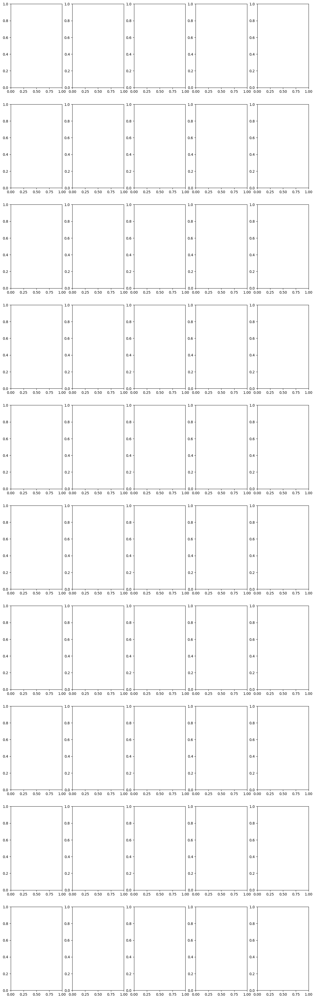

In [11]:
import torch
import torchvision.transforms as transforms
import matplotlib.pyplot as plt
import numpy as np


# Define the actual subject IDs and number of images per subject
subject_ids = [1, 2, 5, 7]
num_subjects = len(subject_ids)
num_images = 10

# Define the transformation to convert tensors to PIL images
to_pil = transforms.ToPILImage()

# Generator for pipeline
generator = torch.Generator(device=device).manual_seed(33)

# Create a dictionary to hold the original and reconstructed images by subject
original_images = {subject: [] for subject in subject_ids}
reconstructed_images = {subject: [] for subject in subject_ids}

# Iterate through the subject_test_ids and collect the first num_images images for each subject
for idx, subject in enumerate(NSD_subject_test_ids):
    if subject in original_images and len(original_images[subject]) < num_images:
        # Get the embedding and move to the correct device
        img = [y_pred_IP[idx].to(device)]
        
        # Generate the reconstructed image using the pipeline
        stimuli_images = pipeline(
            prompt="",
            num_images_per_prompt=1,
            ip_adapter_image_embeds=img,
            negative_prompt="deformed, ugly, wrong proportion, low res, bad anatomy, worst quality, low quality",
            num_inference_steps=100,
            generator=generator,
        ).images
        
        # Convert the original image to PIL format
        ori_image = to_pil(NSD_test_stimulus[idx])
        
        # Add the images to the corresponding subject's list
        original_images[subject].append(ori_image)
        reconstructed_images[subject].append(stimuli_images[0])
    
    # Break the loop if we have collected enough images for all subjects
    if all(len(images) == num_images for images in original_images.values()):
        break

# Plot the original and reconstructed images side by side
fig, axes = plt.subplots(num_images, num_subjects + 1, figsize=(15, num_images * 5))

# Ensure axes is a 2D array
if num_images == 1:
    axes = axes[np.newaxis, :]
if num_subjects + 1 == 1:
    axes = axes[:, np.newaxis]

for i in range(num_images):
    for col, subject in enumerate(subject_ids):
        if col == 0:
            # Plot the original image
            axes[i, 0].imshow(original_images[subject][i])
            axes[i, 0].axis('off')
            axes[i, 0].set_title('Original Image')
        
        # Plot the reconstructed images for each subject
        axes[i, col + 1].imshow(reconstructed_images[subject][i])
        axes[i, col + 1].axis('off')
        axes[i, col + 1].set_title(f'Subject {subject}')

plt.tight_layout()
plt.show()


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

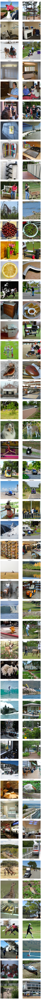

In [12]:
import torch
import matplotlib.pyplot as plt
import torchvision.transforms as transforms
from PIL import Image

# Assuming pipeline is already defined with your Stable Diffusion model
generator = torch.Generator(device="cuda:3").manual_seed(33)

# Transform to convert tensor to PIL image
transform = transforms.ToPILImage()

# Select 50 random indices
indices = torch.randperm(3775)[:50]

fig, axes = plt.subplots(50, 2, figsize=(10, 200))  # 50 rows, 2 columns

for i, idx in enumerate(indices):
    # Convert original stimulus tensor to image
    original_image = transform(BOLD_test_stimulus[idx])

    # Generate image from IP adapter embeddings
    generated_image = pipeline(
        prompt="",
        num_images_per_prompt=1,
        ip_adapter_image_embeds=[y_pred_IP[idx]],
        negative_prompt="deformed, ugly, wrong proportion, low res, bad anatomy, worst quality, low quality",
        num_inference_steps=50,
        generator=generator,
    ).images[0]

    # Plot side-by-side
    axes[i, 0].imshow(original_image)
    axes[i, 0].axis("off")
    axes[i, 0].set_title("Original")

    axes[i, 1].imshow(generated_image)
    axes[i, 1].axis("off")
    axes[i, 1].set_title("Generated")

plt.tight_layout()
plt.show()
